<a href="https://colab.research.google.com/github/mnunezmartinez/08MBID---Visualizacion-de-Datos/blob/main/Malena_Nunez_Martinez_08MBID_TP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Análisis de precios en Airbnb

Importamos las bibliotecas instaladas

In [1]:
import pandas as pd
import numpy as np
import re

import matplotlib.pyplot as plt
import seaborn as sns

import folium
from folium.plugins import HeatMap

Cargamos el dataset

In [2]:
from google.colab import drive

# Montar Google Drive en el entorno
drive.mount('/content/drive')

# Ruta al archivo en Google Drive
file_path = '/content/drive/MyDrive/Colab Notebooks/08MBID - Visualización de datos/TP/listings_limpio_08MBID.csv'

# Cargar el archivo
data = pd.read_csv(file_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
data.head()

,id,host_id,host_name,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,host_has_profile_pic,...,calculated_host_listings_count,num_amenities,first_review_dt,last_review_dt,host_since_dt,log_accommodates,log_bedrooms,log_beds,log_review_scores_rating,host_country
0,18674,71615,mireia and maria,"barcelona, spain",within an hour,100.0,94.0,False,42.0,True,...,20,433.0,2013-05-27 00:00:00,2022-10-07 00:00:00,2010-01-19,2.079442,1.098612,1.791759,1.460938,spain
1,124342,548084,maria,"barcelona, spain",within a day,60.0,43.0,False,7.0,True,...,1,368.0,2011-06-01 00:00:00,2022-10-28 00:00:00,2011-05-01,0.693147,0.000000,0.000000,1.517323,spain
2,128463,635253,sebastian,"barcelona, spain",within an hour,100.0,100.0,True,1.0,True,...,1,821.0,2011-09-03 00:00:00,2022-12-04 00:00:00,2011-05-28,0.693147,0.000000,0.000000,1.583094,spain
3,130227,641496,dolors,"barcelona, spain",_MISSING_,0.0,100.0,False,1.0,True,...,1,1035.0,2014-04-29 00:00:00,2022-09-25 00:00:00,2011-05-30,0.693147,1.098612,0.000000,1.551809,spain
4,135513,664196,teresa,"barcelona, spain",within an hour,83.0,18.0,False,2.0,True,...,2,684.0,2011-10-05 00:00:00,2021-09-23 00:00:00,2011-06-04,1.609438,0.693147,1.098612,1.534714,spain


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15407 entries, 0 to 15406
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              15407 non-null  int64  
 1   host_id                         15407 non-null  int64  
 2   host_name                       15407 non-null  object 
 3   host_location                   15407 non-null  object 
 4   host_response_time              15407 non-null  object 
 5   host_response_rate              15407 non-null  float64
 6   host_acceptance_rate            15407 non-null  float64
 7   host_is_superhost               15407 non-null  bool   
 8   host_total_listings_count       15407 non-null  float64
 9   host_has_profile_pic            15407 non-null  bool   
 10  host_identity_verified          15407 non-null  bool   
 11  neighbourhood_cleansed          15407 non-null  object 
 12  neighbourhood_group_cleansed    

In [5]:
columnas_deseadas = ['id', 'latitude', 'longitude', 'price', 'review_scores_rating']
df_columnas_deseadas = data.loc[:, columnas_deseadas]

print(df_columnas_deseadas.head())

       id   latitude  longitude  price  review_scores_rating
0   18674  41.405560    2.17262  129.0                  4.31
1  124342  41.382481    2.18115   60.0                  4.56
2  128463  41.371550    2.13664   60.0                  4.87
3  130227  41.407790    2.21146   80.0                  4.72
4  135513  41.397870    2.20429   90.0                  4.64


In [6]:
# Verificar si hay valores duplicados en la columna "id"
duplicates = data['id'].duplicated()

# Comprobar si existen valores duplicados
if duplicates.any():
    print("Hay valores duplicados en la columna 'id'.")
else:
    print("No hay valores duplicados en la columna 'id'.")


No hay valores duplicados en la columna 'id'.


## Histograma: Precio por noche

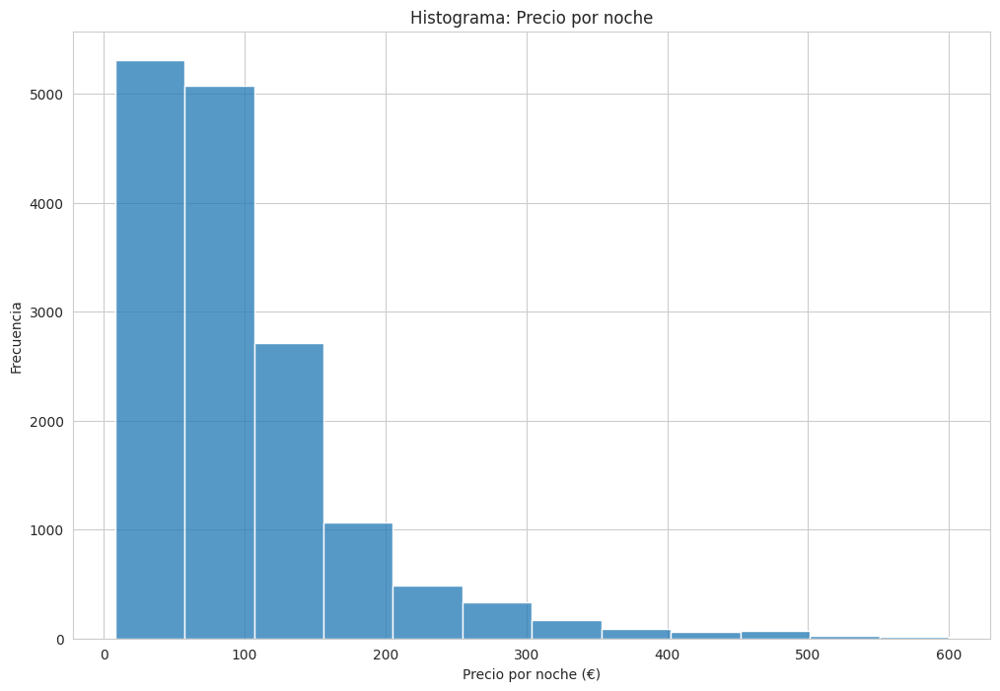

In [7]:
# Obtener los valores de la columna "price"
prices = data['price']

# Histograma
sns.set_style("whitegrid")
plt.figure(figsize=(12, 8))  # Establece el tamaño de la figura (ancho, alto)
ax = sns.histplot(data=prices, bins=12)

ax.set_title("Histograma: Precio por noche")

ax.set_xlabel("Precio por noche (€)")
ax.set_ylabel("Frecuencia")

plt.show()


## Boxplot: Distribución de precios

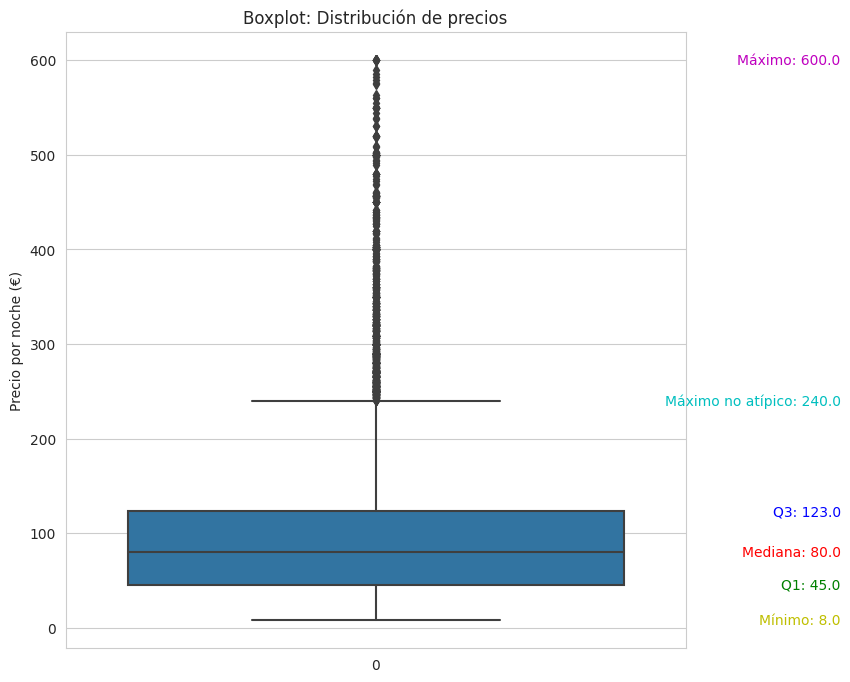

In [8]:
# Diagrama de cajas
plt.figure(figsize=(8, 8))
ax = sns.boxplot(prices)

ax.set_title("Boxplot: Distribución de precios")

ax.set_ylabel("Precio por noche (€)")

# Valores de interés
statistics = prices.describe()
mean = statistics['50%']
q1 = statistics['25%']
q3 = statistics['75%']
max_value = statistics['max']
min_value = statistics['min']
# Límites de los bigotes
iqr = q3 - q1
lower_whisker = q1 - 1.5 * iqr
upper_whisker = q3 + 1.5 * iqr

# Agregar los valores de interés como texto en el gráfico
ax.text(0.75, mean, f"Mediana: {mean}", ha='right', va='center', color='r')
ax.text(0.75, q1, f"Q1: {q1}", ha='right', va='center', color='g')
ax.text(0.75, q3, f"Q3: {q3}", ha='right', va='center', color='b')
ax.text(0.75, max_value, f"Máximo: {max_value}", ha='right', va='center', color='m')
ax.text(0.75, min_value, f"Mínimo: {min_value}", ha='right', va='center', color='y')
ax.text(0.75, upper_whisker, f"Máximo no atípico: {upper_whisker}", ha='right', va='center', color='c')
#ax.text(0.75, lower_whisker, f"Mínimo no atípico: {lower_whisker}", ha='right', va='center', color='orange')

plt.show()


## Conversión de bathrooms_text a numérico

In [9]:
# Definir una función para extraer los números
def extract_numbers(text):
    numbers = re.findall(r'\d+(?:\.\d+)?', text)
    return float(numbers[0]) if numbers else None

# Aplicar la función a la columna 'bathrooms text' y crear una nueva columna 'bathrooms'
data['bathrooms'] = data['bathrooms_text'].apply(extract_numbers)

In [10]:
print(data['bathrooms'])

0        2.0
1        1.0
2        1.0
3        2.0
4        1.5
        ... 
15402    1.5
15403    1.5
15404    1.5
15405    2.0
15406    1.5
Name: bathrooms, Length: 15407, dtype: float64


## Relaciones lineales

In [11]:
# Realciones lineales

# Obtén los valores de 'price' y 'accomodates' como arreglos NumPy
price = data['price'].values
accomodates = data['accommodates'].values

# Ajuste lineal usando polyfit
coefficients = np.polyfit(accomodates, price, 1)

# Los coefficients[0] es la pendiente, coefficients[1] es la intersección con el eje y
pendiente = coefficients[0]
interseccion = coefficients[1]

# Imprime la ecuación lineal
print(f'Ecuación lineal: price = {pendiente} * accommodates + {interseccion}')

Ecuación lineal: price = 20.896821507914563 * accommodates + 26.97233257298323


In [12]:
# Realciones lineales

# Obtén los valores de 'price' y 'accomodates' como arreglos NumPy
price = data['price'].values
bedrooms = data['bedrooms'].values

# Ajuste lineal usando polyfit
coefficients = np.polyfit(bedrooms, price, 1)

# Los coefficients[0] es la pendiente, coefficients[1] es la intersección con el eje y
pendiente = coefficients[0]
interseccion = coefficients[1]

# Imprime la ecuación lineal
print(f'Ecuación lineal: price = {pendiente} * bedrooms + {interseccion}')

Ecuación lineal: price = 37.876696762009196 * bedrooms + 34.347900950497454


In [13]:
# Realciones lineales

# Obtén los valores de 'price' y 'accomodates' como arreglos NumPy
price = data['price'].values
beds = data['beds'].values

# Ajuste lineal usando polyfit
coefficients = np.polyfit(beds, price, 1)

# Los coefficients[0] es la pendiente, coefficients[1] es la intersección con el eje y
pendiente = coefficients[0]
interseccion = coefficients[1]

# Imprime la ecuación lineal
print(f'Ecuación lineal: price = {pendiente} * beds + {interseccion}')

Ecuación lineal: price = 21.514767934098 * beds + 46.69255880069456


## Gráfico de dispersión Precio vs Calificación

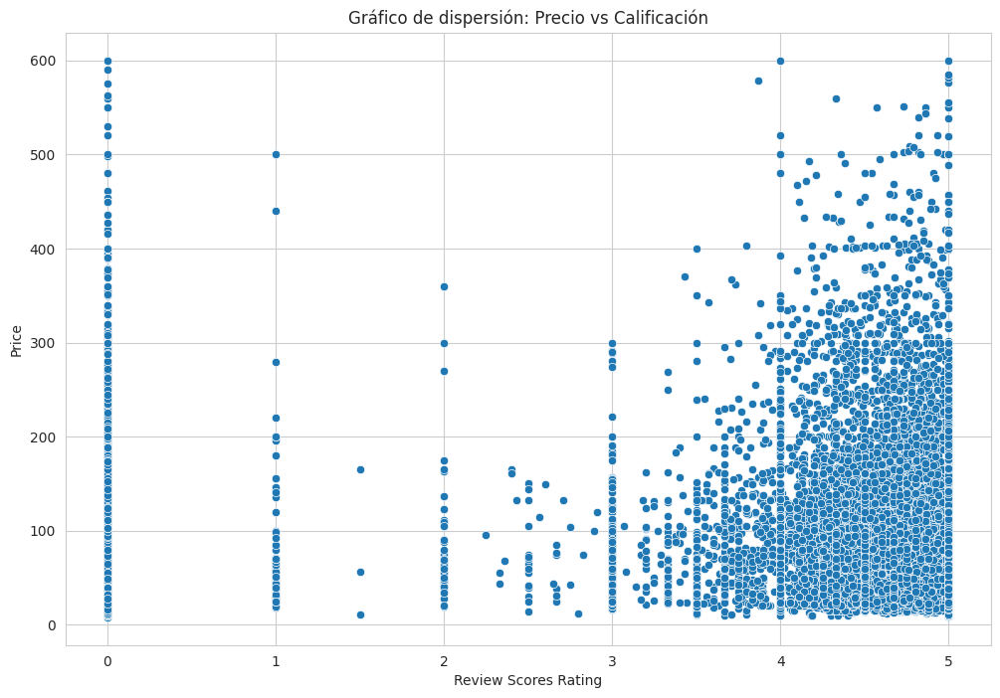

In [14]:
# Gráfico de dispersión price vs review
sns.set_style("whitegrid")
plt.figure(figsize=(12, 8))
sns.scatterplot(data=data, x='review_scores_rating', y='price')

plt.xlabel('Review Scores Rating')
plt.ylabel('Price')
plt.title('Gráfico de dispersión: Precio vs Calificación')

plt.show()

## Gráfico de dispersión: Número de calificaciones vs Puntuación

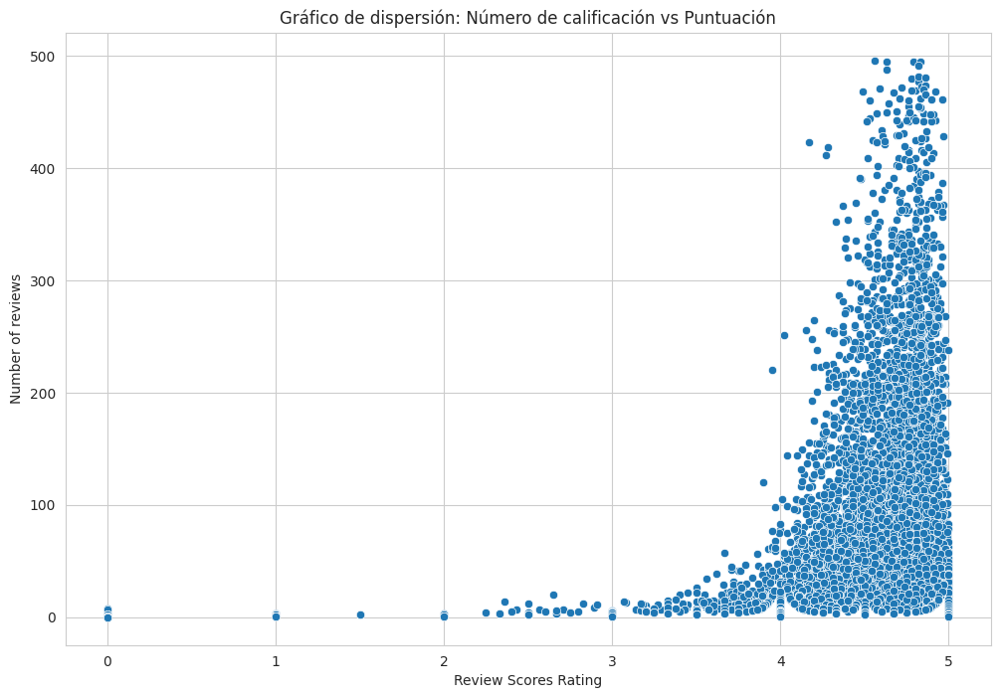

In [15]:
# Gráfico de dispersión price vs review
sns.set_style("whitegrid")
plt.figure(figsize=(12, 8))
sns.scatterplot(data=data, x='review_scores_rating', y='number_of_reviews')

plt.xlabel('Review Scores Rating')
plt.ylabel('Number of reviews')
plt.title('Gráfico de dispersión: Número de calificación vs Puntuación')

plt.show()

In [16]:
# Filtrar el DataFrame original
filtered_df_price = data[(data['price'] >= 45) & (data['price'] <= 123)]

# Mostrar el nuevo DataFrame
print(filtered_df_price.info())


<class 'pandas.core.frame.DataFrame'>
Int64Index: 7924 entries, 1 to 15406
Data columns (total 38 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              7924 non-null   int64  
 1   host_id                         7924 non-null   int64  
 2   host_name                       7924 non-null   object 
 3   host_location                   7924 non-null   object 
 4   host_response_time              7924 non-null   object 
 5   host_response_rate              7924 non-null   float64
 6   host_acceptance_rate            7924 non-null   float64
 7   host_is_superhost               7924 non-null   bool   
 8   host_total_listings_count       7924 non-null   float64
 9   host_has_profile_pic            7924 non-null   bool   
 10  host_identity_verified          7924 non-null   bool   
 11  neighbourhood_cleansed          7924 non-null   object 
 12  neighbourhood_group_cleansed    7

## Mapa interactivo: Densidad de alojamientos

In [17]:
# Obtén las coordenadas de latitud y longitud de cada propiedad
locations = data[['latitude', 'longitude']].values

# Agrupar las propiedades por ubicación y obtén el recuento de propiedades en cada ubicación
property_counts = data.groupby(['latitude', 'longitude']).size().reset_index(name='count')

# Construir el mapa
bcn_map = folium.Map(location=[41.38879, 2.15899], tiles='stamenterrain', zoom_start=13)

# Crear una capa de calor (heatmap) utilizando el recuento de propiedades como datos de intensidad
HeatMap(property_counts.values, radius=10).add_to(bcn_map)

# Visualiza el mapa
bcn_map


## Mapa interactivo de precio, calificación y número de hupéspedes

In [18]:
# Crea un nuevo mapa
property_map = folium.Map(location=[41.38879, 2.15899], tiles='stamenterrain', zoom_start=14)

# Itera sobre cada propiedad en tu dataset
for index, row in data.iterrows():

  # Obtén la ubicación (latitud y longitud) de la propiedad
  latitude = row['latitude']
  longitude = row['longitude']

  # Obtener los valores para el tooltip y el popup
  price = row['price']
  accommodates = row['accommodates']
  number_of_reviews = row['number_of_reviews']
  review_scores_rating = row['review_scores_rating']

  # Define el tamaño o el color del punto según el precio del alquiler
  if price < 45:  # El precio es menor a 45
    point_color = 'green'
  elif price < 123:  # El precio está entre 45 y 123
    point_color = 'yellow'
  else:  # El precio es mayor a 123
    point_color = 'red'

  # Crea un círculo para representar cada propiedad y añádelo al mapa
  folium.Circle(
      location=[latitude, longitude],
      radius=3,  # Tamaño del círculo en píxeles
      color=point_color,  # Color del borde del círculo
      fill=True,  # Rellena el círculo
      fill_color=point_color,  # Color de relleno del círculo
      popup=f"Price: {price}<br>Accommodates: {accommodates}<br>Reviews: {number_of_reviews}<br>Rating: {review_scores_rating}"
  ).add_to(property_map)

# Visualiza el mapa
property_map
